In [1]:
import scanpy as sc
import numpy as np
import os
data_type = 'float32'
os.environ["THEANO_FLAGS"] = 'device=cuda,floatX=' + data_type + ',force_device=True'
import cell2location
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')
from cell2location.models import RegressionModel
from pathlib import Path


def read_and_qc(path, sample_name, hasMT=False):
    adata = sc.read_visium(path, count_file='filtered_feature_bc_matrix.h5', load_images=True)
    adata.obs['sample'] = sample_name
    adata.var['SYMBOL'] = adata.var_names
    adata.var.rename(columns={'gene_ids': 'ENSEMBL'}, inplace=True)
    adata_var_geneids = adata.var[['SYMBOL', 'ENSEMBL']].drop_duplicates(subset=['SYMBOL'])['ENSEMBL'].unique()
    adata = adata[:,adata.var['ENSEMBL'].isin(adata_var_geneids)]
    adata.var_names = adata.var['SYMBOL']
    sc.pp.calculate_qc_metrics(adata, inplace=True)
    if hasMT:
        adata.var['mt'] = [gene.startswith('MT-') for gene in adata.var['SYMBOL']]
        adata.obs['mt_frac'] = adata[:, adata.var['mt'].tolist()].X.sum(1).A.squeeze() / adata.obs['total_counts']
        adata.obsm['mt'] = adata[:, adata.var['mt'].values].X.toarray()
        adata = adata[:, ~adata.var['mt'].values]
    adata.obs["sample"] = adata.obs["sample"].astype(object)
    adata.obs_names = adata.obs["sample"] + '_' + adata.obs_names
    adata.obs.index.name = 'spot_id'
    return adata


def train_cell2loc_model(adata_ref,
                         adata_vis,
                         ncells_per_location,
                         detection_alpha,
                         write_prefix,
                         batch_key='sample'):
    if 'means_per_cluster_mu_fg' in adata_ref.varm.keys():
        inf_aver = adata_ref.varm['means_per_cluster_mu_fg'][[f'means_per_cluster_mu_fg_{i}'
                                                              for i in adata_ref.uns['mod']['factor_names']]].copy()
    else:
        inf_aver = adata_ref.var[[f'means_per_cluster_mu_fg_{i}'
                                          for i in adata_ref.uns['mod']['factor_names']]].copy()
    inf_aver.columns = adata_ref.uns['mod']['factor_names']
    intersect = np.intersect1d(adata_vis.var_names, inf_aver.index)
    adata_vis = adata_vis[:, intersect].copy()
    inf_aver = inf_aver.loc[intersect, :].copy()
    cell2location.models.Cell2location.setup_anndata(adata=adata_vis,
                                                     batch_key=batch_key,
                                                     continuous_covariate_keys=['total_counts',
                                                                                'n_genes_by_counts',
                                                                                'mt_frac'])
    # create and train the model
    print("cell2location model setup")
    mod = cell2location.models.Cell2location(
        adata_vis,
        cell_state_df=inf_aver,
        N_cells_per_location=ncells_per_location,
        detection_alpha=detection_alpha
    )
    print(mod.view_anndata_setup())
    print("####### Start with Cell2location training model.")
    mod.train(max_epochs=30000,
              batch_size=None,
              train_size=1)
    # plot ELBO loss history during training, removing first 100 epochs from the plot
    mod.plot_history(1000)
    plt.legend(labels=['full data training'])
    if not os.path.exists(write_prefix / f"ncell{ncells_per_location}_alpha{detection_alpha}"):
        os.mkdir(write_prefix / f"ncell{ncells_per_location}_alpha{detection_alpha}")
    plt.savefig(write_prefix / f'cell2loc_model_ncell{ncells_per_location}_alpha{detection_alpha}.training_history.png')
    # export the estimated cell abundance (summary of the posterior distribution).
    print("Export the estimated cell abundance")
    adata_vis = mod.export_posterior(
        adata_vis, sample_kwargs={'num_samples': 1000,
                                  'batch_size': mod.adata.n_obs}
    )
    mod.save(write_prefix / f"ncell{ncells_per_location}_alpha{detection_alpha}", overwrite=True)
    print('cell2location model saved in', write_prefix / f'cell2loc_model_ncell7_alpha{detection_alpha}')
    # add 5% quantile, representing confident cell abundance, 'at least this amount is present'
    adata_vis.obs[adata_vis.uns['mod']['factor_names']] = adata_vis.obsm['q05_cell_abundance_w_sf']
    print("computing KNN from estimated cell abundance")
    sc.pp.neighbors(adata_vis, use_rep='q05_cell_abundance_w_sf', n_neighbors=15)
    sc.tl.leiden(adata_vis, resolution=1.1)
    adata_vis.obs["region_cluster"] = adata_vis.obs["leiden"].astype("category")
    sc.tl.umap(adata_vis, min_dist=0.3, spread=1)
    adata_file = write_prefix / f"ncell{ncells_per_location}_alpha{detection_alpha}/sp.h5ad"
    adata_vis.write(adata_file)
    print("Saved visium data with estimated cell abundance, umap, leiden")
    return adata_vis


def load_heart_region_visium(region):
    print('Loading visium data..')
    prefix1 = Path("/nfs/team205/ly5/adult_endo/visium/heart/heart-imperial")
    sample_names = {'ventricle': ['RTR02-HHH4-LV', 'RTR02-HHH2-LV-2-2',
                                  'RTR02-HHH2-LV-2-1', 'RTR02-HHH2-LV-1-2',
                                  'RTR02-HHH2-LV-1-1'],
                    'atrium': ['RTR02-HHH2-RA', 'RTR02-HHH4-LA', 'RTR02-HHH1-LA']}
    region_sample_names = sample_names[region]
    print(f'For heart {region}, these samples will be loaded..', region_sample_names)
    slides = []
    for sample in region_sample_names:
        slide = read_and_qc(prefix1 / sample / 'outs', sample, hasMT=True)
        slides.append(slide)
    if len(slides) > 1:
        adata_vis = slides[0].concatenate(
            slides[1:],
            batch_key="sample",
            uns_merge="unique",
            batch_categories=region_sample_names,
            index_unique=None
        )
        print('Visium data loaded.')
    else:
        adata_vis = slides[0]
    return adata_vis


def load_heart_ref_region(path):
    print('Loading heart reference..')
    cleaned_heart_ref = sc.read(path)
    return cleaned_heart_ref

Loading heart reference..
Loading visium data..
For heart ventricle, these samples will be loaded.. ['RTR02-HHH4-LV', 'RTR02-HHH2-LV-2-2', 'RTR02-HHH2-LV-2-1', 'RTR02-HHH2-LV-1-2', 'RTR02-HHH2-LV-1-1']
Visium data loaded.


An NVIDIA GPU may be present on this machine, but a CUDA-enabled jaxlib is not installed. Falling back to cpu.


cell2location model setup


Anndata setup with scvi-tools version 1.1.5.

Setup via `Cell2location.setup_anndata` with arguments:

{
│   'layer': None,
│   'batch_key': 'sample',
│   'labels_key': None,
│   'categorical_covariate_keys': None,
│   'continuous_covariate_keys': ['total_counts', 'n_genes_by_counts', 'mt_frac']
}

         Summary Statistics         
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┓
┃     Summary Stat Key     ┃ Value ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━┩
│         n_batch          │   5   │
│         n_cells          │ 10569 │
│ n_extra_categorical_covs │   0   │
│ n_extra_continuous_covs  │   3   │
│         n_labels         │   1   │
│          n_vars          │ 12450 │
└──────────────────────────┴───────┘

                            Data Registry                            
┏━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃     Registry Key      ┃            scvi-tools Location            ┃
┡━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│           X           │                  adata.X                  │
│         batch         │         adata.obs['_scvi_batch']          │
│ extra_continuous_covs │ adata.obsm['_scvi_extra_continuous_covs'] │
│         ind_x         │           adata.obs['_indices']           │
│        labels         │         adata.obs['_scvi_labels']         │
└───────────────────────┴───────────────────────────────────────────┘

                      batch State Registry                       
┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃   Source Location   ┃    Categories     ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['sample'] │   RTR02-HHH4-LV   │          0          │
│                     │ RTR02-HHH2-LV-2-2 │          1          │
│                     │ RTR02-HHH2-LV-2-1 │          2          │
│                     │ RTR02-HHH2-LV-1-2 │          3          │
│                     │ RTR02-HHH2-LV-1-1 │          4          │
└─────────────────────┴───────────────────┴─────────────────────┘

                     labels State Registry                      
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃      Source Location      ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['_scvi_labels'] │     0      │          0          │
└───────────────────────────┴────────────┴─────────────────────┘

   extra_continuous_covs State    
             Registry             
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Source Location         ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│   adata.obs['total_counts']    │
│ adata.obs['n_genes_by_counts'] │
│      adata.obs['mt_frac']      │
└────────────────────────────────┘

None
####### Start with Cell2location training model.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
You are using a CUDA device ('NVIDIA A100-SXM4-80GB') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 30000/30000: 100%|███████████| 30000/30000 [39:49<00:00, 12.76it/s, v_num=1, elbo_train=1.35e+8]

`Trainer.fit` stopped: `max_epochs=30000` reached.


Epoch 30000/30000: 100%|███████████| 30000/30000 [39:49<00:00, 12.55it/s, v_num=1, elbo_train=1.35e+8]
Export the estimated cell abundance
Sampling global variables, sample: 100%|████████████████████████████| 999/999 [00:13<00:00, 71.36it/s]
cell2location model saved in heart_ven/cell2loc_model_ncell7_alpha20
computing KNN from estimated cell abundance
Saved visium data with estimated cell abundance, umap, leiden


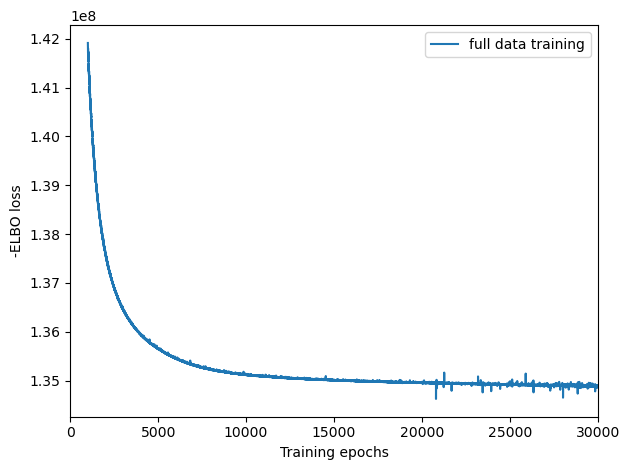

In [2]:
vis_region = "ventricle"
ref_path = "heart_ven/ref.posterior.h5ad"
save_prefix = "heart_ven/"
trained_ref = load_heart_ref_region(ref_path)
save_prefix = Path(save_prefix)
trained_visium = train_cell2loc_model(trained_ref,
                                      load_heart_region_visium(vis_region),
                                      ncells_per_location=7,
                                      detection_alpha=20,
                                      write_prefix=save_prefix,
                                      batch_key='sample')

In [3]:
trained_visium = sc.read_h5ad("heart_ven/ncell7_alpha20/sp.h5ad")
trained_visium

AnnData object with n_obs × n_vars = 10569 × 12450
    obs: 'in_tissue', 'array_row', 'array_col', 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac', '_indices', '_scvi_batch', '_scvi_labels', 'B cells', 'Epithelial cells', 'Fibroblasts', 'Lymphoid cells', 'Myeloid cells', 'art_ec_1', 'art_ec_2', 'art_smc', 'cap_lec', 'cap_pc', 'endocardial_ec', 'myo_cap_ec', 'smc_pc_intermediate', 'vCM', 'ven_ec_1', 'leiden', 'region_cluster'
    var: 'ENSEMBL', 'feature_types', 'genome', 'SYMBOL', 'mt', 'n_cells_by_counts-RTR02-HHH2-LV-1-1', 'mean_counts-RTR02-HHH2-LV-1-1', 'log1p_mean_counts-RTR02-HHH2-LV-1-1', 'pct_dropout_by_counts-RTR02-HHH2-LV-1-1', 'total_counts-RTR02-HHH2-LV-1-1', 'log1p_total_counts-RTR02-HHH2-LV-1-1', 'n_cells_by_counts-RTR02-HHH2-LV-1-2', 'mean_counts-RTR02-HHH2-LV-1-2', 'log1p_mean_counts-RTR02-HH

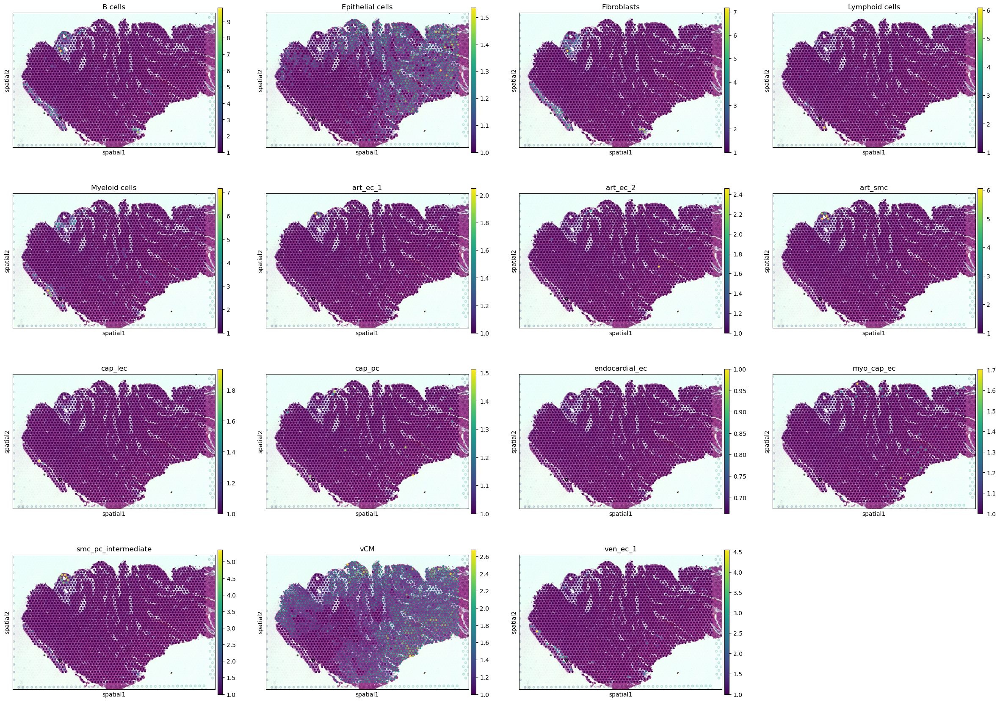

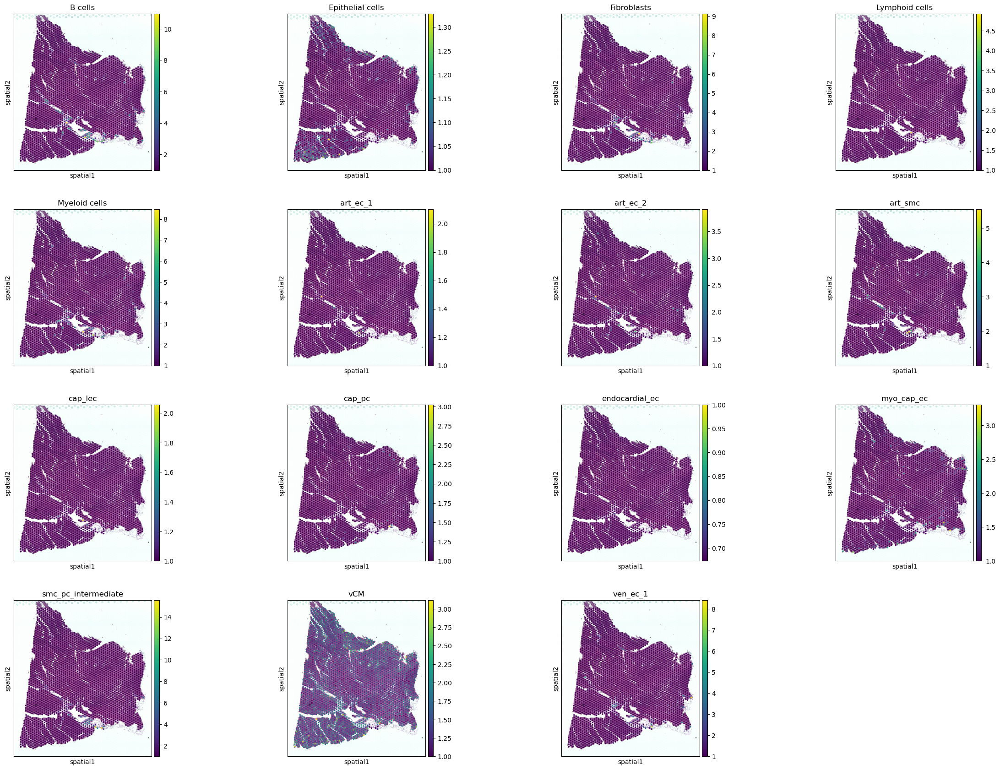

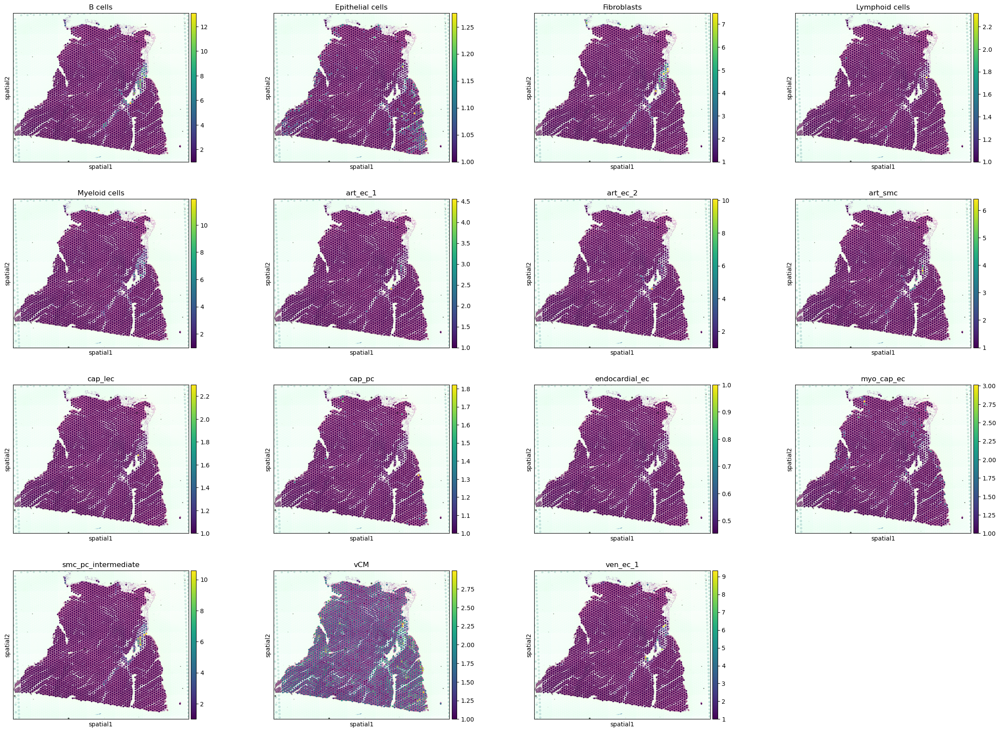

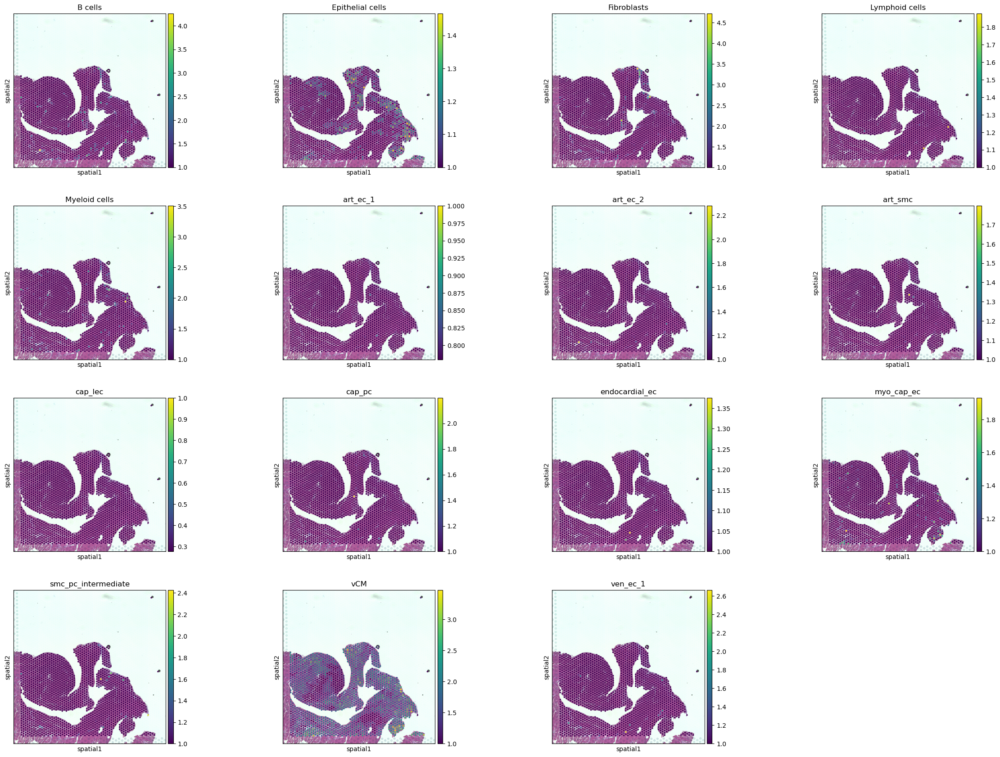

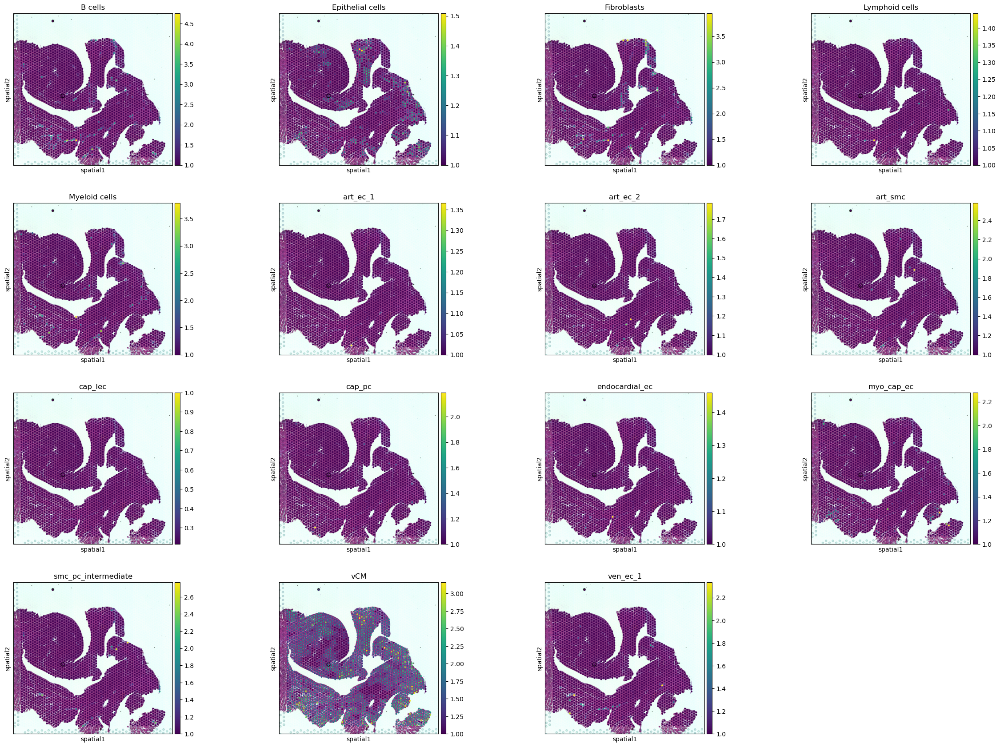

In [4]:
for samplename in trained_visium.obs['sample'].unique():
    sc.pl.spatial(trained_visium[trained_visium.obs['sample'] == samplename],
                  color=trained_visium.uns['mod']['factor_names'],
                  library_id=samplename, vmin=1)

Loading heart reference..
Loading visium data..
For heart atrium, these samples will be loaded.. ['RTR02-HHH2-RA', 'RTR02-HHH4-LA', 'RTR02-HHH1-LA']
Visium data loaded.
cell2location model setup


Anndata setup with scvi-tools version 1.1.5.

Setup via `Cell2location.setup_anndata` with arguments:

{
│   'layer': None,
│   'batch_key': 'sample',
│   'labels_key': None,
│   'categorical_covariate_keys': None,
│   'continuous_covariate_keys': ['total_counts', 'n_genes_by_counts', 'mt_frac']
}

         Summary Statistics         
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┓
┃     Summary Stat Key     ┃ Value ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━┩
│         n_batch          │   3   │
│         n_cells          │ 5369  │
│ n_extra_categorical_covs │   0   │
│ n_extra_continuous_covs  │   3   │
│         n_labels         │   1   │
│          n_vars          │ 12606 │
└──────────────────────────┴───────┘

                            Data Registry                            
┏━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃     Registry Key      ┃            scvi-tools Location            ┃
┡━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│           X           │                  adata.X                  │
│         batch         │         adata.obs['_scvi_batch']          │
│ extra_continuous_covs │ adata.obsm['_scvi_extra_continuous_covs'] │
│         ind_x         │           adata.obs['_indices']           │
│        labels         │         adata.obs['_scvi_labels']         │
└───────────────────────┴───────────────────────────────────────────┘

                    batch State Registry                     
┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃   Source Location   ┃  Categories   ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['sample'] │ RTR02-HHH2-RA │          0          │
│                     │ RTR02-HHH4-LA │          1          │
│                     │ RTR02-HHH1-LA │          2          │
└─────────────────────┴───────────────┴─────────────────────┘

                     labels State Registry                      
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃      Source Location      ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['_scvi_labels'] │     0      │          0          │
└───────────────────────────┴────────────┴─────────────────────┘

   extra_continuous_covs State    
             Registry             
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Source Location         ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│   adata.obs['total_counts']    │
│ adata.obs['n_genes_by_counts'] │
│      adata.obs['mt_frac']      │
└────────────────────────────────┘

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


None
####### Start with Cell2location training model.


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 30000/30000: 100%|███████████| 30000/30000 [28:06<00:00, 17.28it/s, v_num=1, elbo_train=4.76e+7]

`Trainer.fit` stopped: `max_epochs=30000` reached.


Epoch 30000/30000: 100%|███████████| 30000/30000 [28:06<00:00, 17.79it/s, v_num=1, elbo_train=4.76e+7]
Export the estimated cell abundance
Sampling global variables, sample: 100%|████████████████████████████| 999/999 [00:11<00:00, 88.10it/s]
cell2location model saved in heart_atrial/cell2loc_model_ncell7_alpha20
computing KNN from estimated cell abundance
Saved visium data with estimated cell abundance, umap, leiden


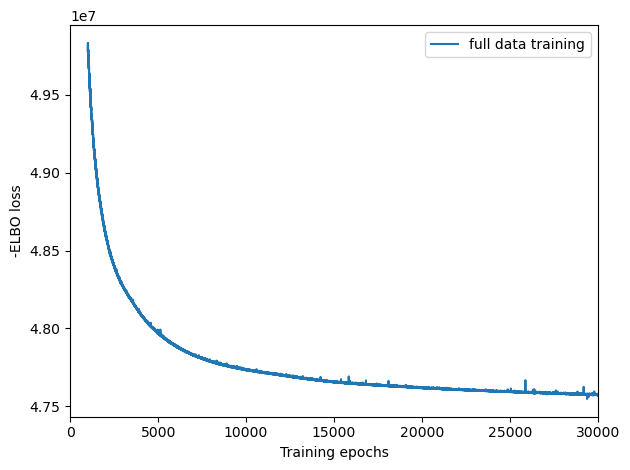

In [6]:
vis_region = "atrium"
ref_path = "heart_atrial/ref.posterior.h5ad"
save_prefix = "heart_atrial/"
trained_ref = load_heart_ref_region(ref_path)
save_prefix = Path(save_prefix)
trained_visium = train_cell2loc_model(trained_ref,
                                      load_heart_region_visium(vis_region),
                                      ncells_per_location=7,
                                      detection_alpha=20,
                                      write_prefix=save_prefix,
                                      batch_key='sample')

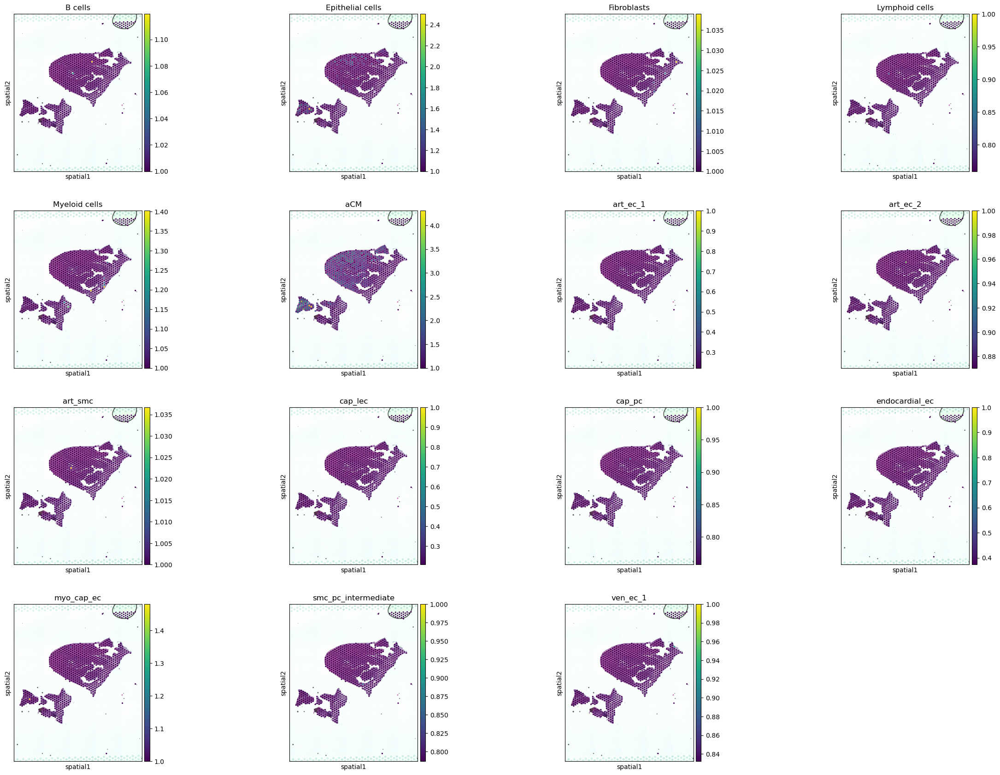

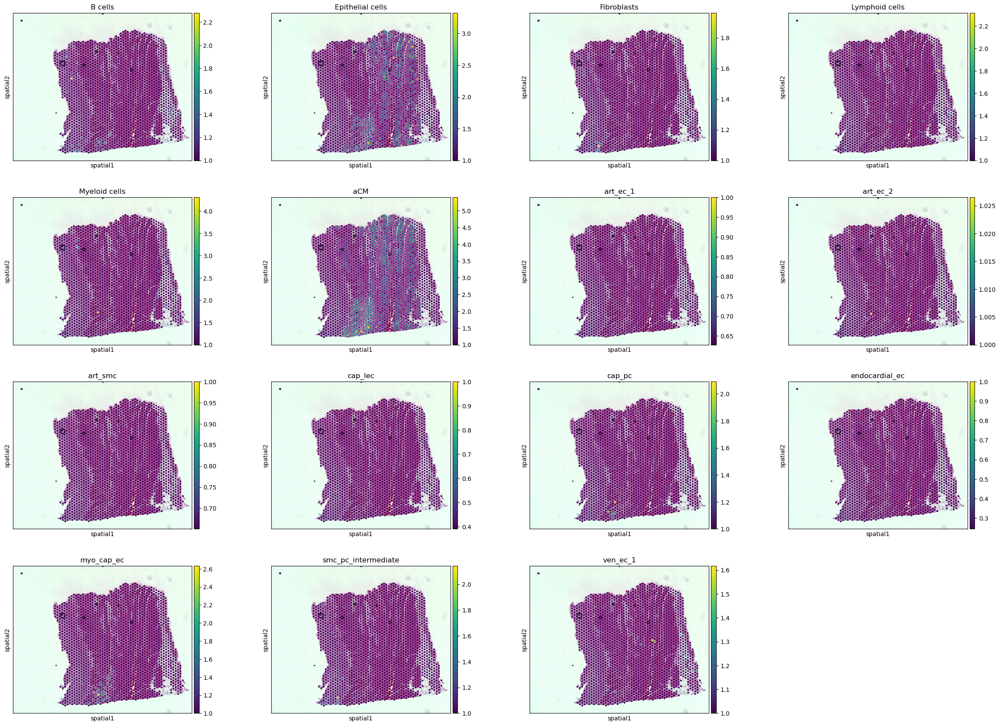

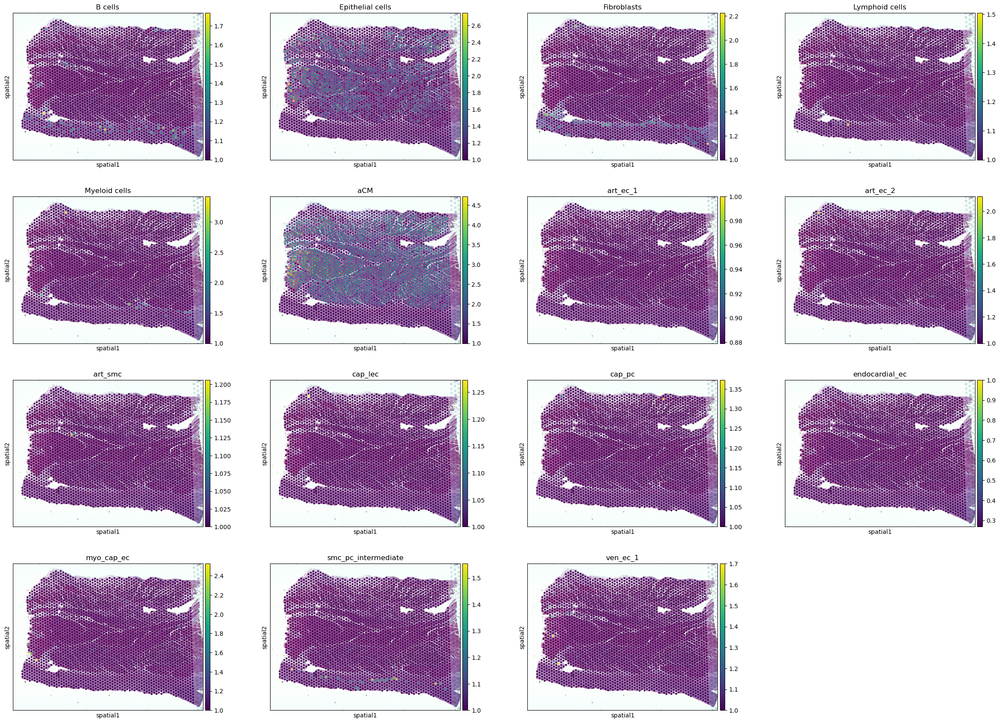

In [8]:
trained_visium = sc.read_h5ad("heart_atrial/ncell7_alpha20/sp.h5ad")
for samplename in trained_visium.obs['sample'].unique():
    sc.pl.spatial(trained_visium[trained_visium.obs['sample'] == samplename],
                  color=trained_visium.uns['mod']['factor_names'],
                  library_id=samplename, vmin=1)

# all heart slides

Loading visium data..
For heart ventricle, these samples will be loaded.. ['RTR02-HHH4-LV', 'RTR02-HHH2-LV-2-2', 'RTR02-HHH2-LV-2-1', 'RTR02-HHH2-LV-1-2', 'RTR02-HHH2-LV-1-1']
Visium data loaded.
Loading visium data..
For heart atrium, these samples will be loaded.. ['RTR02-HHH2-RA', 'RTR02-HHH4-LA', 'RTR02-HHH1-LA']
Visium data loaded.
Loading heart reference..


An NVIDIA GPU may be present on this machine, but a CUDA-enabled jaxlib is not installed. Falling back to cpu.


cell2location model setup


Anndata setup with scvi-tools version 1.1.5.

Setup via `Cell2location.setup_anndata` with arguments:

{
│   'layer': None,
│   'batch_key': 'sample',
│   'labels_key': None,
│   'categorical_covariate_keys': None,
│   'continuous_covariate_keys': ['total_counts', 'n_genes_by_counts', 'mt_frac']
}

         Summary Statistics         
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┓
┃     Summary Stat Key     ┃ Value ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━┩
│         n_batch          │   8   │
│         n_cells          │ 15938 │
│ n_extra_categorical_covs │   0   │
│ n_extra_continuous_covs  │   3   │
│         n_labels         │   1   │
│          n_vars          │ 12490 │
└──────────────────────────┴───────┘

                            Data Registry                            
┏━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃     Registry Key      ┃            scvi-tools Location            ┃
┡━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│           X           │                  adata.X                  │
│         batch         │         adata.obs['_scvi_batch']          │
│ extra_continuous_covs │ adata.obsm['_scvi_extra_continuous_covs'] │
│         ind_x         │           adata.obs['_indices']           │
│        labels         │         adata.obs['_scvi_labels']         │
└───────────────────────┴───────────────────────────────────────────┘

                      batch State Registry                       
┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃   Source Location   ┃    Categories     ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['sample'] │   RTR02-HHH1-LA   │          0          │
│                     │ RTR02-HHH2-LV-1-1 │          1          │
│                     │ RTR02-HHH2-LV-1-2 │          2          │
│                     │ RTR02-HHH2-LV-2-1 │          3          │
│                     │ RTR02-HHH2-LV-2-2 │          4          │
│                     │   RTR02-HHH2-RA   │          5          │
│                     │   RTR02-HHH4-LA   │          6          │
│                     │   RTR02-HHH4-LV   │          7          │
└─────────────────────┴───────────────────┴─────────────────────┘

                     labels State Registry                      
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃      Source Location      ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['_scvi_labels'] │     0      │          0          │
└───────────────────────────┴────────────┴─────────────────────┘

   extra_continuous_covs State    
             Registry             
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Source Location         ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│   adata.obs['total_counts']    │
│ adata.obs['n_genes_by_counts'] │
│      adata.obs['mt_frac']      │
└────────────────────────────────┘

None
####### Start with Cell2location training model.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
You are using a CUDA device ('NVIDIA A100-SXM4-80GB') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 30000/30000: 100%|███████████| 30000/30000 [53:04<00:00,  9.51it/s, v_num=1, elbo_train=1.82e+8]

`Trainer.fit` stopped: `max_epochs=30000` reached.


Epoch 30000/30000: 100%|███████████| 30000/30000 [53:04<00:00,  9.42it/s, v_num=1, elbo_train=1.82e+8]
Export the estimated cell abundance
Sampling global variables, sample: 100%|████████████████████████████| 999/999 [00:17<00:00, 57.13it/s]
cell2location model saved in heart_ref/cell2loc_model_ncell7_alpha20
computing KNN from estimated cell abundance
Saved visium data with estimated cell abundance, umap, leiden


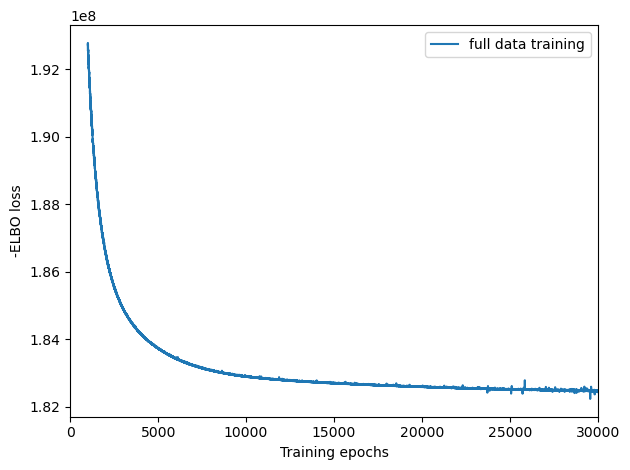

In [3]:
from anndata import concat

ref_path = "heart_ref/ref.posterior.h5ad"
save_prefix = "heart_ref/"
save_prefix = Path(save_prefix)

ven_vis_sc = load_heart_region_visium("ventricle")
atrial_vis_sc = load_heart_region_visium("atrium")
heart_vis = concat([ven_vis_sc, atrial_vis_sc], merge='same', uns_merge='unique')

trained_ref = load_heart_ref_region(ref_path)
trained_visium = train_cell2loc_model(trained_ref,
                                      heart_vis,
                                      ncells_per_location=7,
                                      detection_alpha=20,
                                      write_prefix=save_prefix,
                                      batch_key='sample')

In [10]:
trained_visium.uns['mod']['factor_names']

['B cells',
 'CM',
 'Epithelial cells',
 'Fibroblasts',
 'Lymphoid cells',
 'Myeloid cells',
 'art_ec_1',
 'art_ec_2',
 'art_smc',
 'cap_lec',
 'cap_pc',
 'endocardial_ec',
 'myo_cap_ec',
 'smc_pc_intermediate',
 'ven_ec_1']

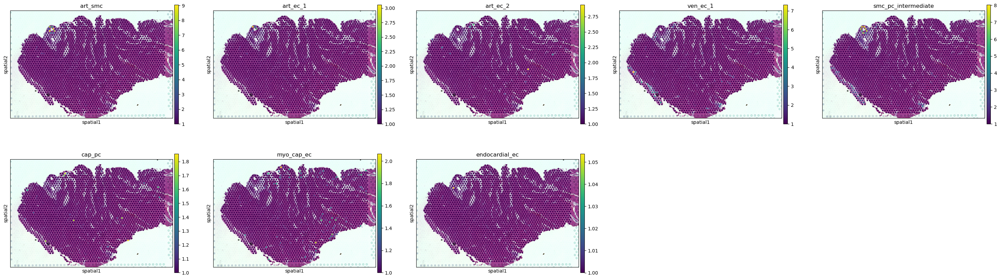

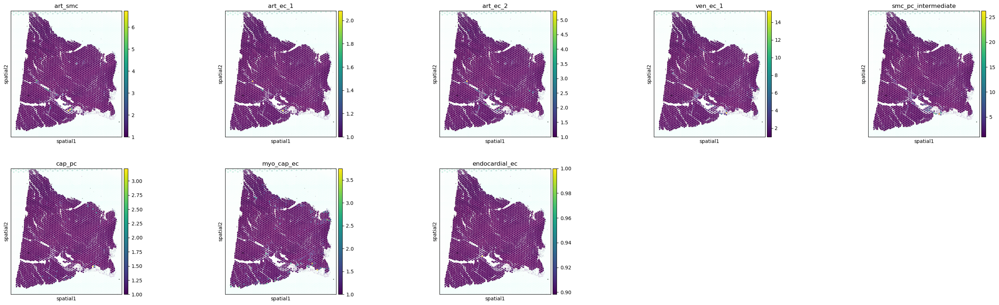

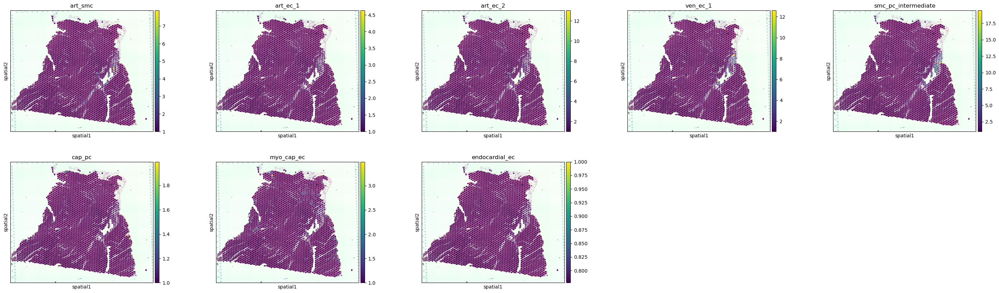

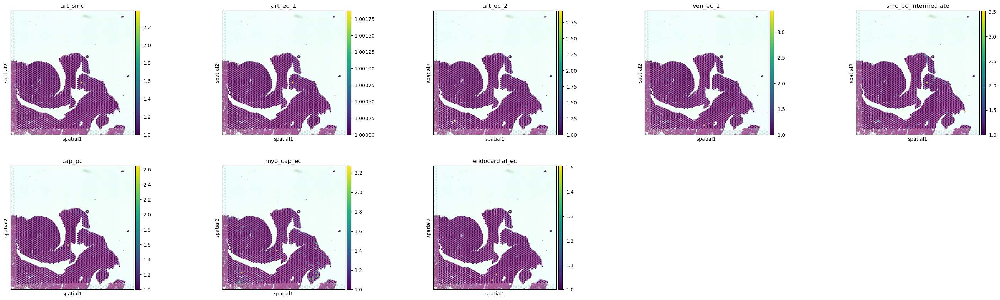

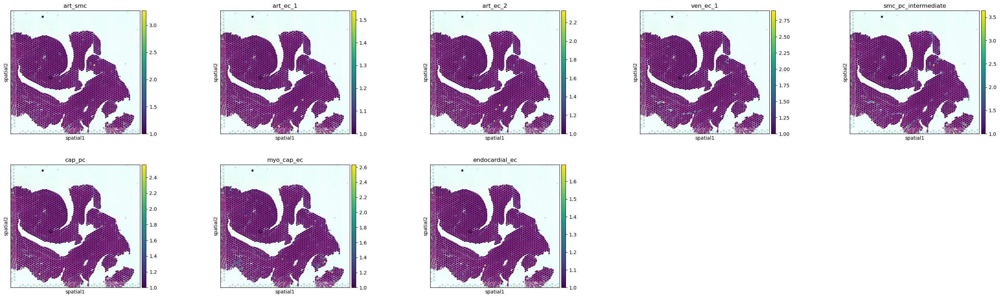

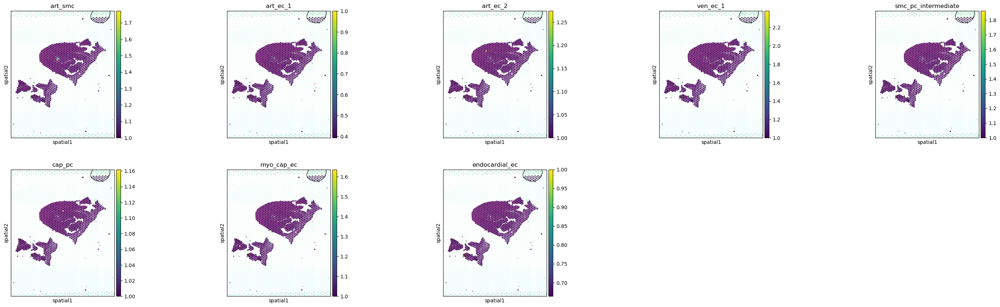

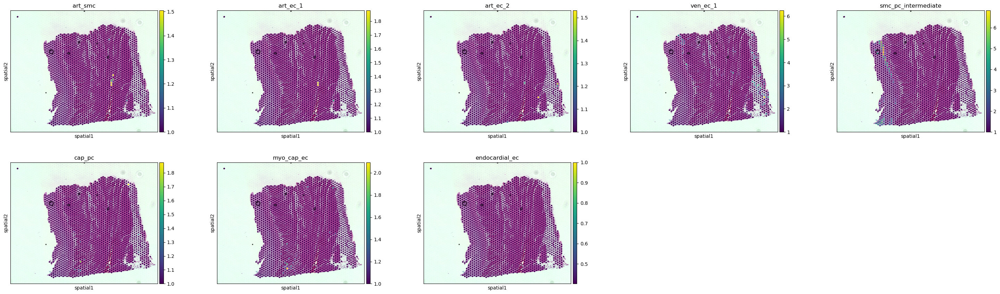

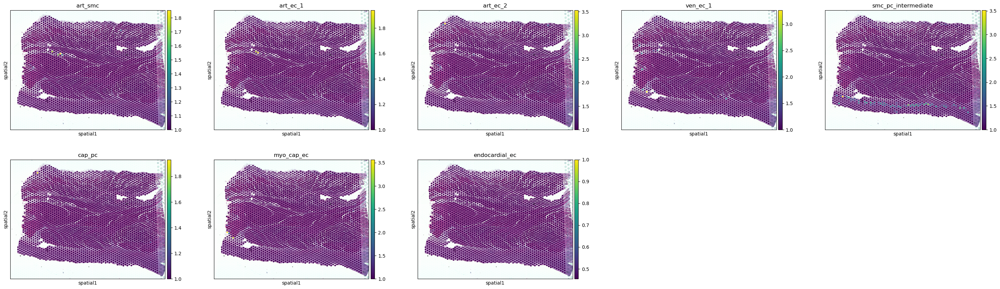

In [14]:
for samplename in trained_visium.obs['sample'].unique():
    sc.pl.spatial(trained_visium[trained_visium.obs['sample'] == samplename],
                  color=['art_smc', 'art_ec_1', 'art_ec_2', 'ven_ec_1', 'smc_pc_intermediate', 'cap_pc', 'myo_cap_ec', 'endocardial_ec'],
                  library_id=samplename, vmin=1, ncols=5)